In [1]:
import csv
import random
import numpy as np
from PIL import Image
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import Subset, Dataset, DataLoader, random_split

import matplotlib.pyplot as plt
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

from sklearn.model_selection import StratifiedShuffleSplit

if torch.cuda.is_available():
    device = "cuda"
elif torch.backends.mps.is_available():
    device = "mps"
else:
    device = "cpu"

/Users/valentinbiller/anaconda3/lib/python3.9/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'dlopen(/Users/valentinbiller/anaconda3/lib/python3.9/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c1017RegisterOperatorsD1Ev
  Referenced from: <2D1B8D5C-7891-3680-9CF9-F771AE880676> /Users/valentinbiller/anaconda3/lib/python3.9/site-packages/torchvision/image.so
  Expected in:     <91E09CD3-B54F-3961-87C1-B0D20E3D1C3F> /Users/valentinbiller/anaconda3/lib/python3.9/site-packages/torch/lib/libtorch_cpu.dylib'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [2]:
class CheXpertDataSet(Dataset):
    def __init__(self, image_list_file, transform=None, policy="ones"):
        image_names = []
        labels = []

        with open(image_list_file, "r") as f:
            csvReader = csv.reader(f)
            next(csvReader, None)
            k=0
            for line in csvReader:
                k+=1
                image_name= line[0]
                label = line[5:]
                
                for i in range(14):
                    if label[i]:
                        a = float(label[i])
                        if a == 1:
                            label[i] = 1
                        elif a == -1:
                            if policy == "ones":
                                label[i] = 1
                            elif policy == "zeroes":
                                label[i] = 0
                            else:
                                label[i] = 0
                        else:
                            label[i] = 0
                    else:
                        label[i] = 0
                        
                image_names.append('/Users/valentinbiller/Downloads/' + image_name) # image_names.append('../' + image_name)
                labels.append(label)

        self.image_names = image_names
        self.labels = labels
        self.transform = transform

    def __getitem__(self, index):
        image_name = self.image_names[index]
        image = Image.open(image_name).convert('RGB')
        label = self.labels[index]
        if self.transform is not None:
            image = self.transform(image)
        return image, torch.FloatTensor(label)

    def __len__(self):
        return len(self.image_names)

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [3]:
pathFileTrain = '/Users/valentinbiller/Downloads/CheXpert-v1.0-small/train.csv'
pathFileValid = '/Users/valentinbiller/Downloads/CheXpert-v1.0-small/valid.csv'

dataset = CheXpertDataSet(pathFileTrain ,transform, policy="ones")
datasetTest, datasetTrain = random_split(dataset, [500, len(dataset) - 500])
datasetValid = CheXpertDataSet(pathFileValid, transform)

indicesRandom = random.sample(range(len(datasetTrain)), 10000)
datasetTrainSub = Subset(datasetTrain, indicesRandom)

dataLoaderTrain = DataLoader(dataset=datasetTrainSub, batch_size=64, shuffle=True)
dataLoaderVal = DataLoader(dataset=datasetValid, batch_size=64, shuffle=False)
dataLoaderTest = DataLoader(dataset=datasetTest)

In [9]:
def training(model):

    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    
    num_epochs = 15

    for epoch in range(num_epochs):
        model.train()

        tqdmTrain = tqdm(dataLoaderTrain, desc=f'Epoch {epoch + 1}/{num_epochs}', dynamic_ncols=True)

        for i, (inputs, targets) in enumerate(tqdmTrain):

            inputs, targets = inputs.to(device), targets.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()

            tqdmTrain.set_description(f'Epoch {epoch + 1}/{num_epochs}, Loss: {loss.item():.4f}')

        tqdmTrain.close()

    # =================================================================================================================

        model.eval()

        for inputs, targets in dataLoaderVal:

            inputs, targets = inputs.to(device), targets.to(device)

            img = np.transpose((np.float32(inputs.cpu()) / 255)[0], (1, 2, 0))
            cam = GradCAMPlusPlus(model=model, target_layers=[model.layer4])

            batch_cams_per_category = []
            fig, axes = plt.subplots(1, 14, figsize=(20, 2))

            for class_idx in range(14):
                batch_targets = [ClassifierOutputTarget(class_idx) for _ in range(len(inputs))]
                category_cams = cam(input_tensor=inputs, targets=batch_targets)
                batch_cams_per_category.append(category_cams)

                cam_image = show_cam_on_image(img, category_cams[0, :], use_rgb=True)

                axes[class_idx].imshow(cam_image)
                axes[class_idx].axis('off')
                axes[class_idx].set_title(f'{class_idx}')

            plt.show()




 ========== Without Pretrained Weights ========== 





Epoch 1/15, Loss: 0.4614: 100%|███████████████| 157/157 [16:35<00:00,  6.34s/it]


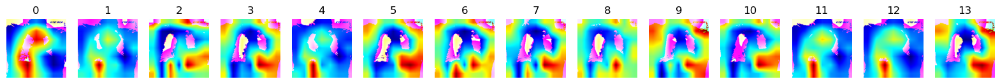

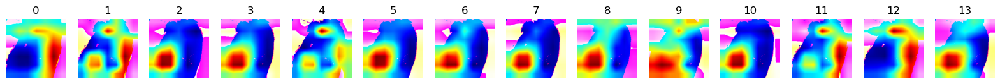

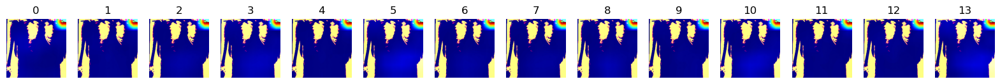

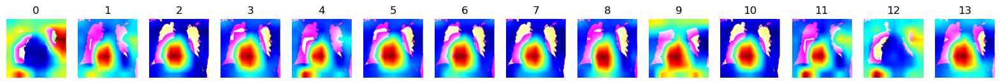

Epoch 2/15, Loss: 0.3941: 100%|███████████████| 157/157 [23:55<00:00,  9.15s/it]


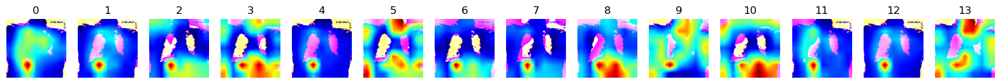

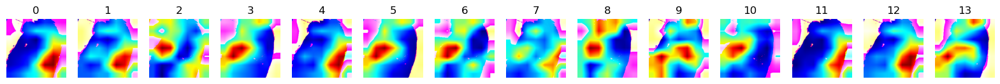

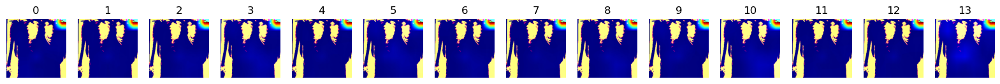

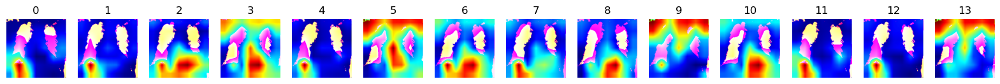

Epoch 3/15, Loss: 0.3355: 100%|███████████████| 157/157 [28:51<00:00, 11.03s/it]


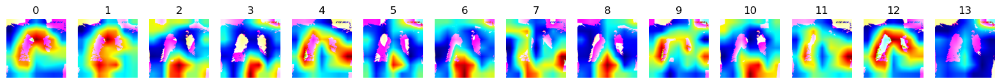

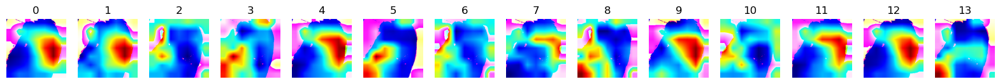

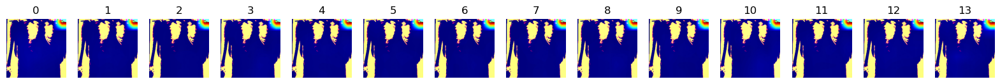

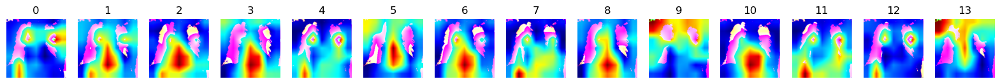

Epoch 4/15, Loss: 0.3927: 100%|███████████████| 157/157 [28:47<00:00, 11.00s/it]


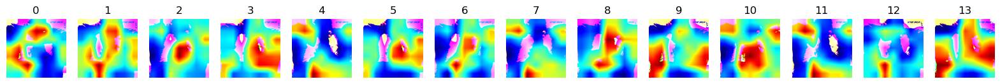

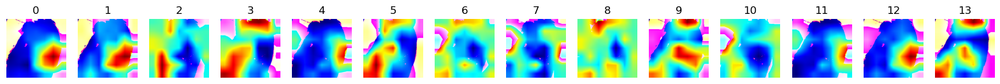

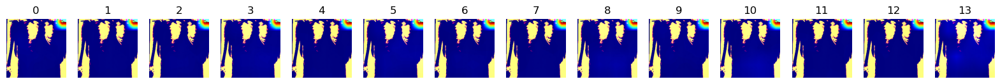

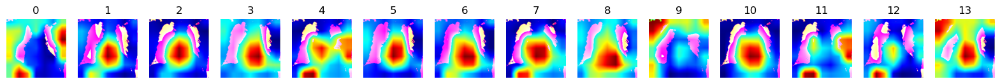

Epoch 5/15, Loss: 0.3616: 100%|███████████████| 157/157 [29:21<00:00, 11.22s/it]


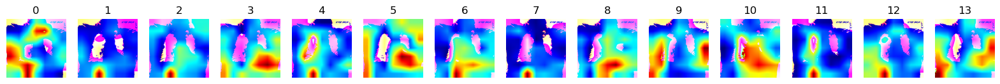

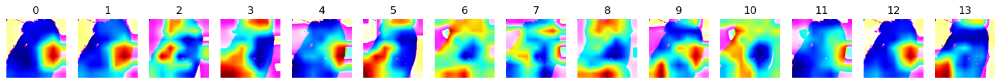

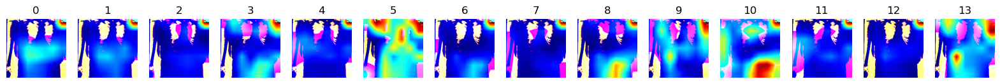

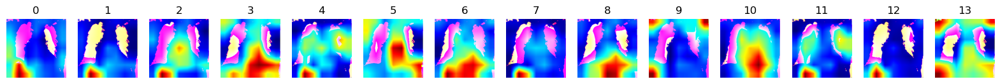

Epoch 6/15, Loss: 0.3725: 100%|███████████████| 157/157 [28:43<00:00, 10.98s/it]


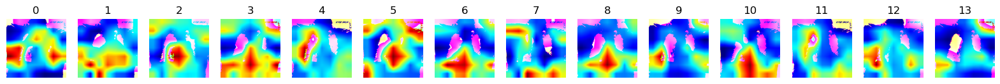

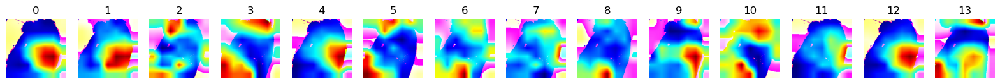

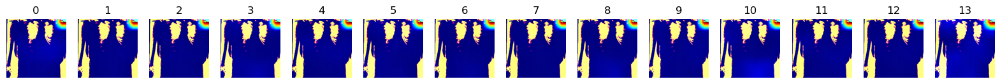

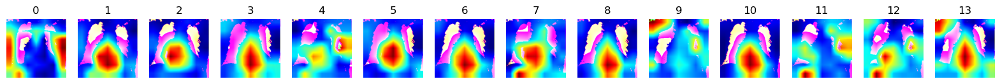

Epoch 7/15, Loss: 0.3861: 100%|███████████████| 157/157 [29:29<00:00, 11.27s/it]


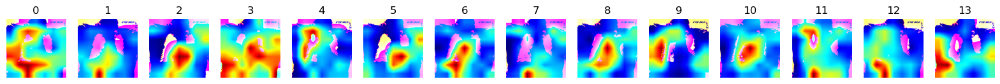

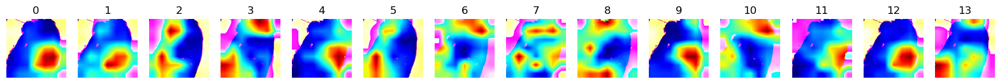

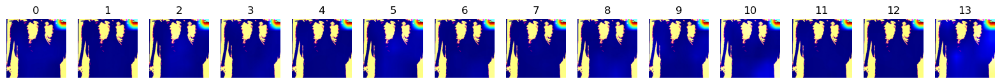

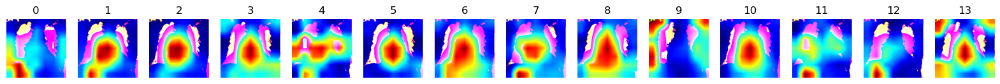

Epoch 8/15, Loss: 0.4081: 100%|███████████████| 157/157 [29:17<00:00, 11.19s/it]


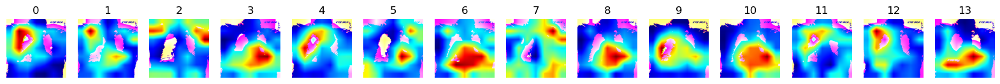

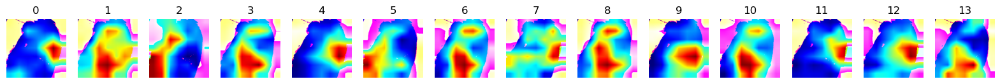

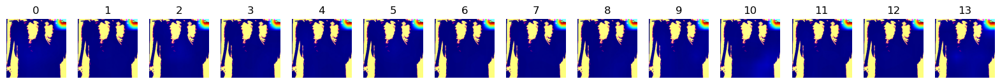

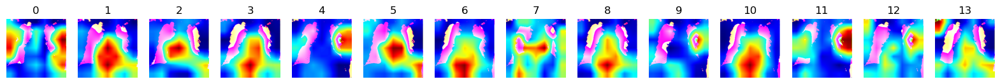

Epoch 9/15, Loss: 0.3878: 100%|███████████████| 157/157 [29:02<00:00, 11.10s/it]


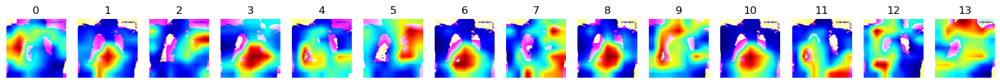

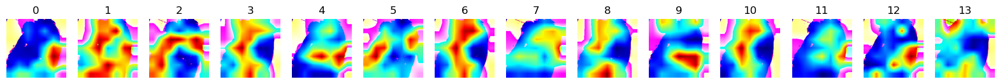

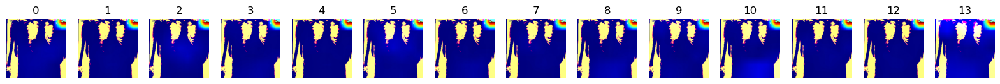

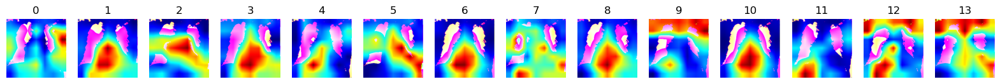

Epoch 10/15, Loss: 0.4015: 100%|██████████████| 157/157 [29:09<00:00, 11.15s/it]


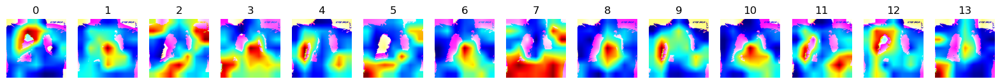

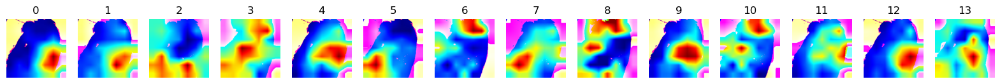

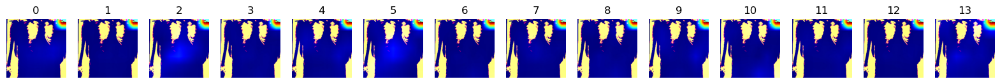

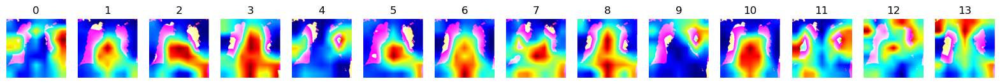

Epoch 11/15, Loss: 0.3932: 100%|██████████████| 157/157 [27:43<00:00, 10.60s/it]


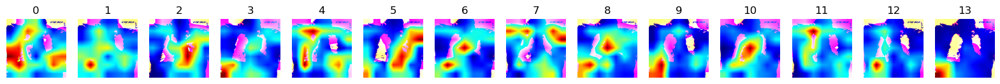

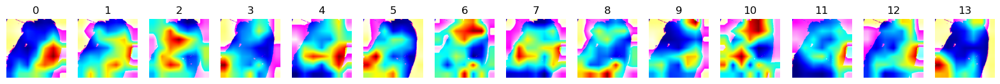

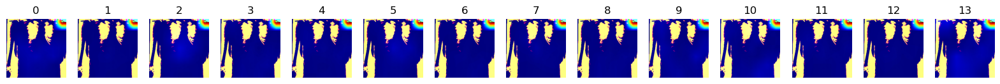

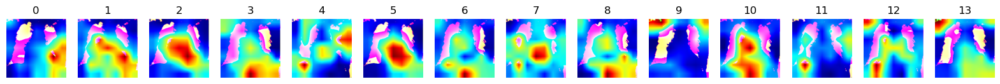

Epoch 12/15, Loss: 0.4166: 100%|██████████████| 157/157 [28:50<00:00, 11.02s/it]


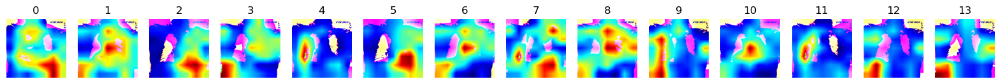

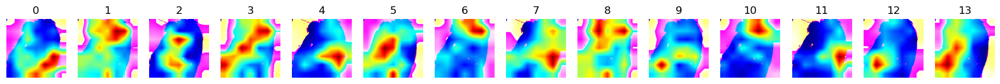

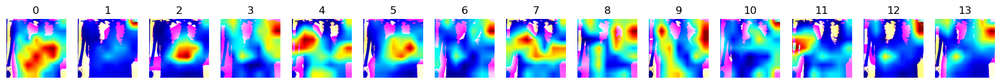

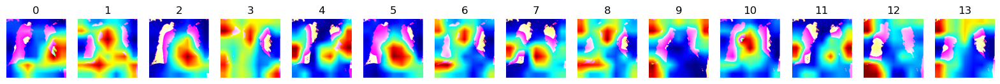

Epoch 13/15, Loss: 0.3461: 100%|██████████████| 157/157 [28:48<00:00, 11.01s/it]


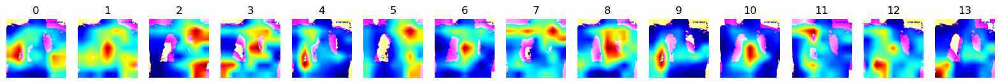

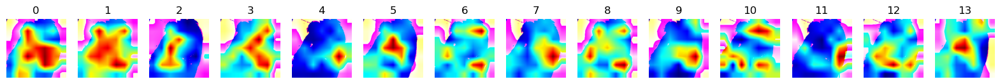

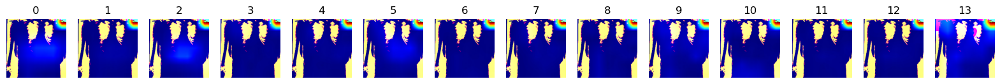

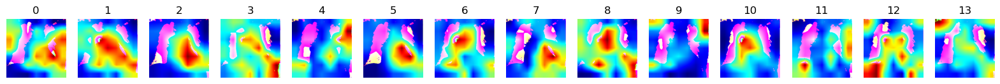

Epoch 14/15, Loss: 0.3519: 100%|██████████████| 157/157 [30:38<00:00, 11.71s/it]


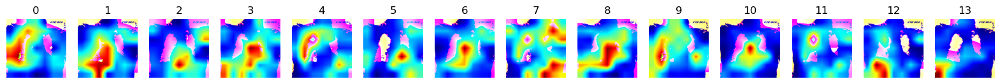

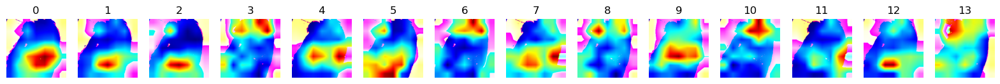

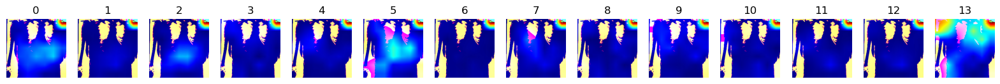

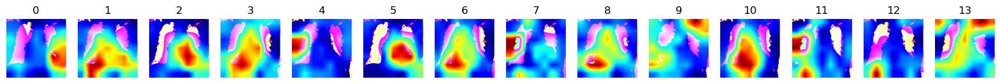

Epoch 15/15, Loss: 0.3717: 100%|██████████████| 157/157 [28:30<00:00, 10.90s/it]


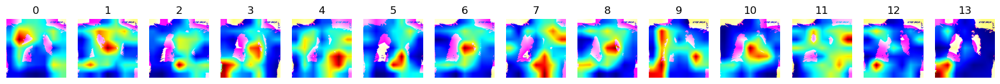

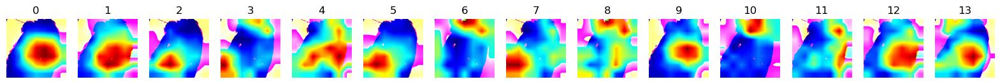

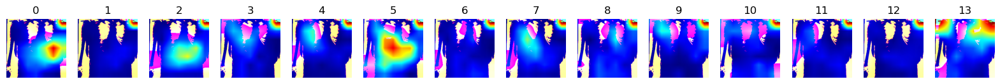

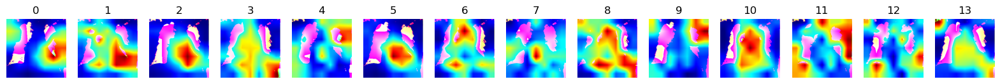




 ========== With Pretrained Weights ========== 





Epoch 1/15, Loss: 0.4148: 100%|███████████████| 157/157 [24:14<00:00,  9.26s/it]


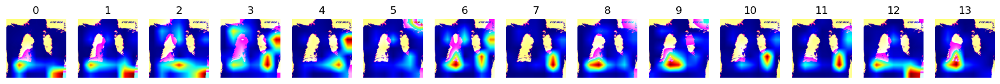

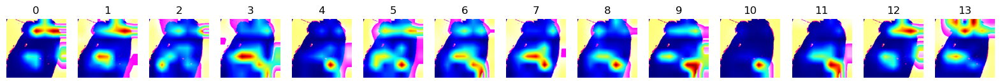

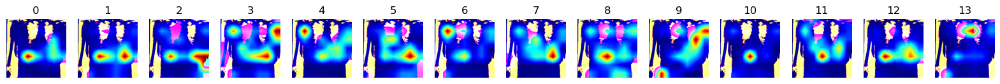

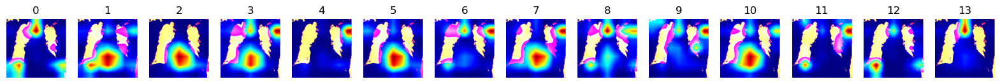

Epoch 2/15, Loss: 0.3969: 100%|███████████████| 157/157 [27:51<00:00, 10.65s/it]


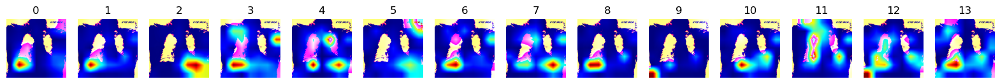

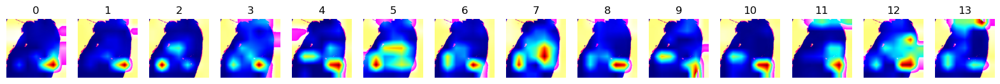

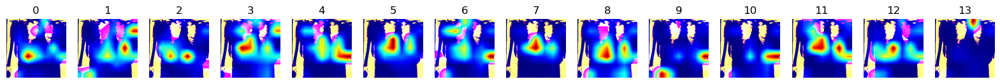

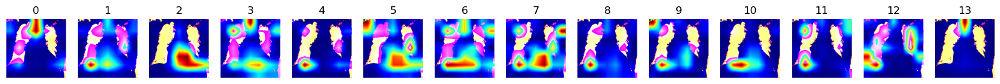

Epoch 3/15, Loss: 0.3534: 100%|███████████████| 157/157 [25:52<00:00,  9.89s/it]


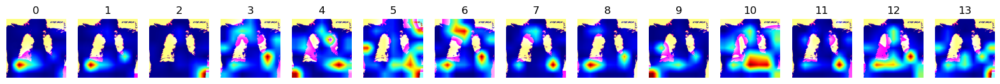

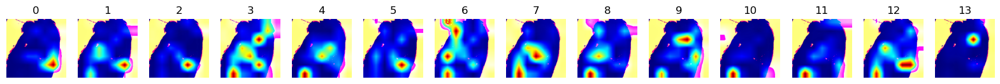

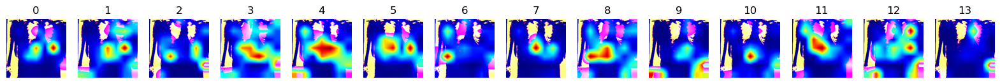

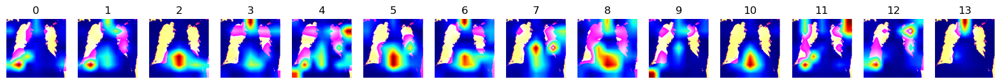

Epoch 4/15, Loss: 0.3864: 100%|███████████████| 157/157 [27:03<00:00, 10.34s/it]


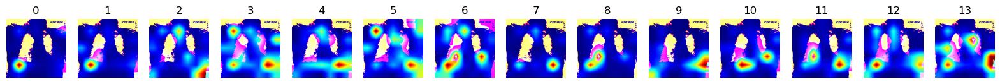

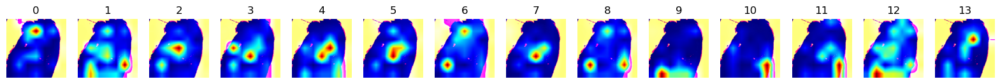

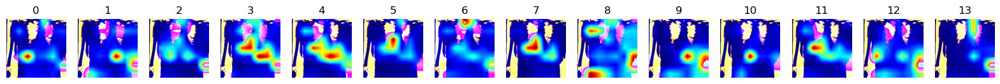

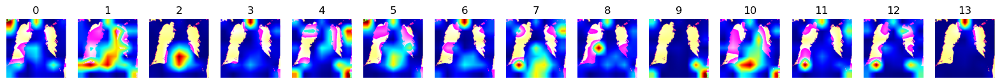

Epoch 5/15, Loss: 0.2924: 100%|███████████████| 157/157 [25:24<00:00,  9.71s/it]


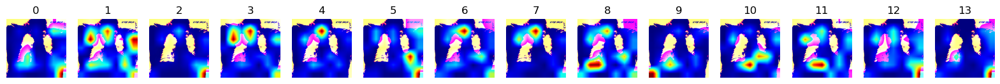

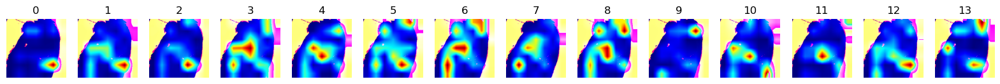

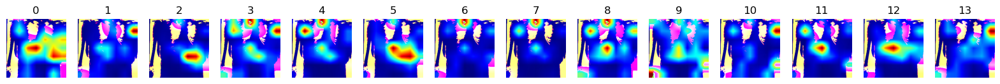

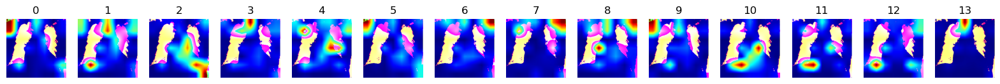

Epoch 6/15, Loss: 0.2962: 100%|███████████████| 157/157 [23:16<00:00,  8.89s/it]


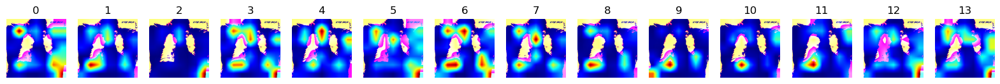

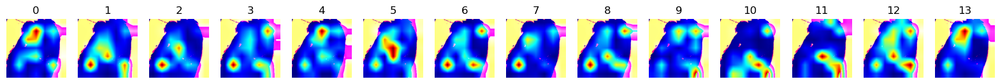

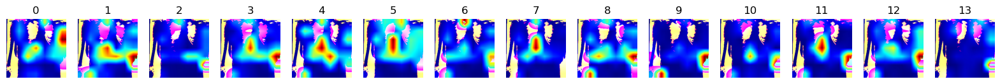

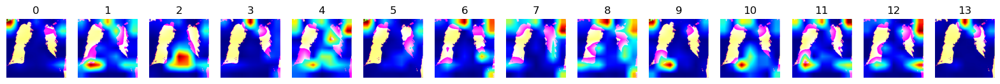

Epoch 7/15, Loss: 0.2533: 100%|███████████████| 157/157 [24:59<00:00,  9.55s/it]


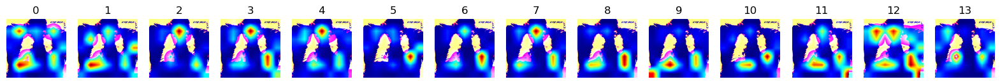

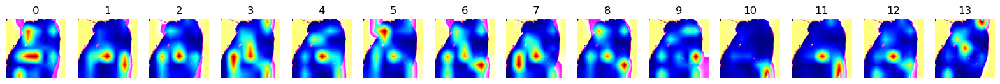

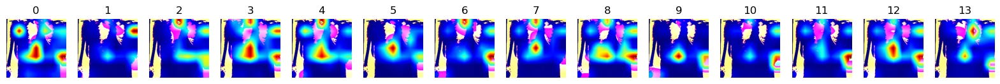

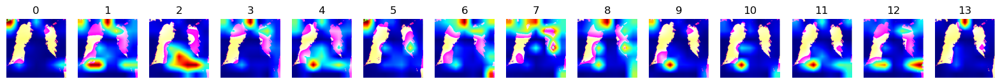

Epoch 8/15, Loss: 0.1678: 100%|███████████████| 157/157 [25:52<00:00,  9.89s/it]


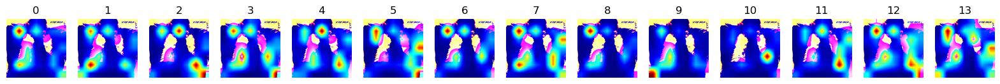

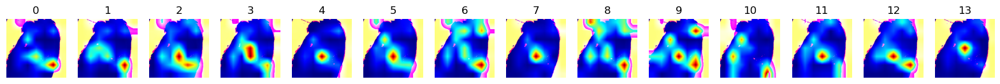

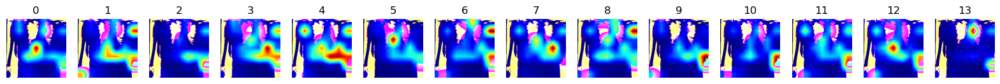

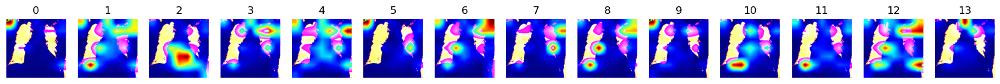

Epoch 9/15, Loss: 0.1652: 100%|███████████████| 157/157 [25:01<00:00,  9.57s/it]


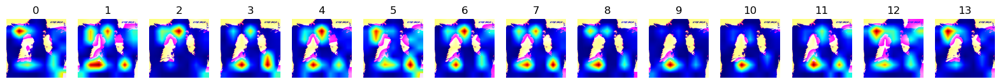

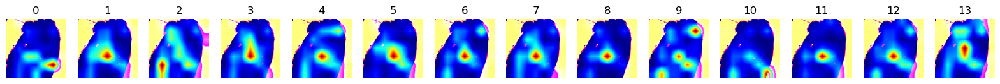

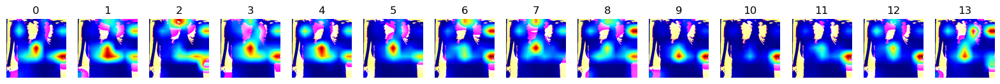

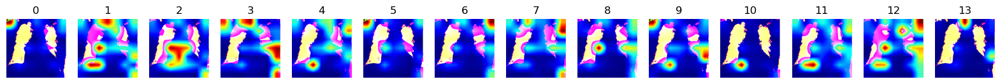

Epoch 10/15, Loss: 0.1106: 100%|██████████████| 157/157 [25:18<00:00,  9.67s/it]


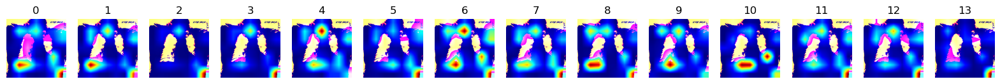

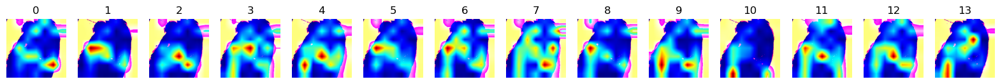

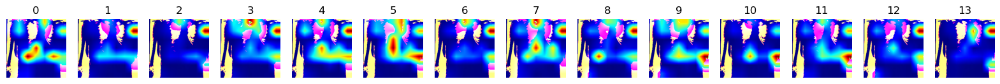

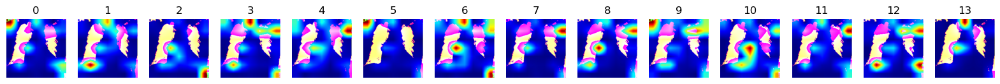

Epoch 11/15, Loss: 0.1555: 100%|██████████████| 157/157 [23:57<00:00,  9.15s/it]


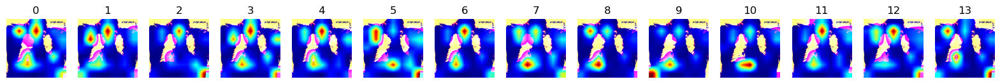

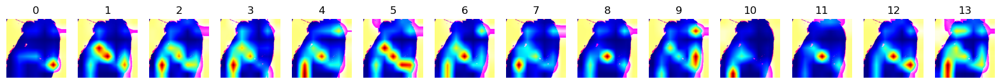

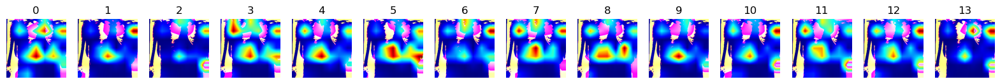

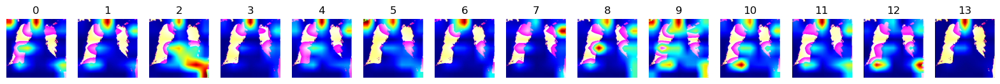

Epoch 12/15, Loss: 0.1051: 100%|██████████████| 157/157 [25:03<00:00,  9.58s/it]


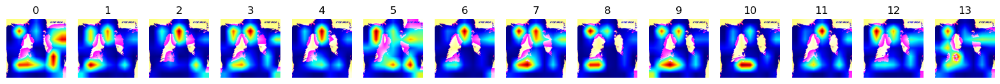

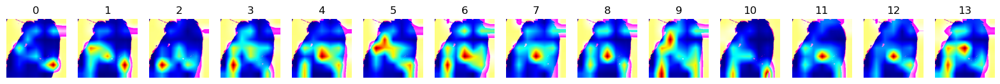

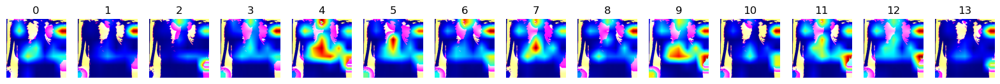

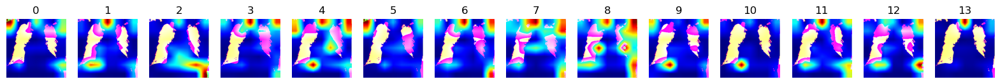

Epoch 13/15, Loss: 0.0556: 100%|██████████████| 157/157 [23:38<00:00,  9.03s/it]


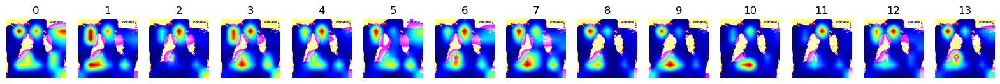

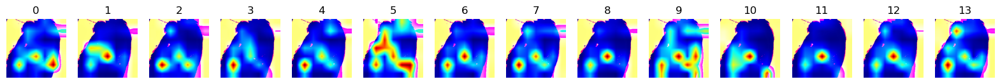

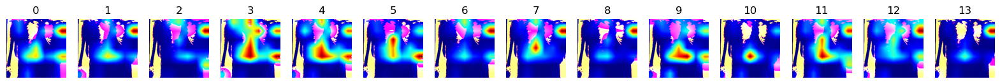

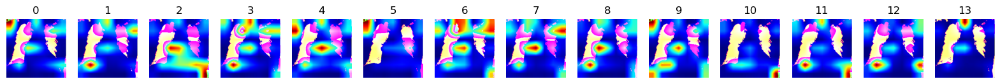

Epoch 14/15, Loss: 0.0286: 100%|██████████████| 157/157 [25:58<00:00,  9.92s/it]


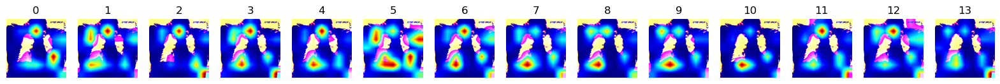

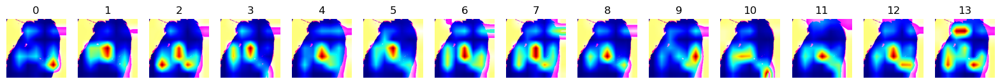

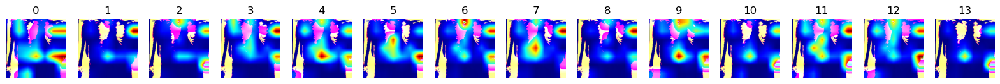

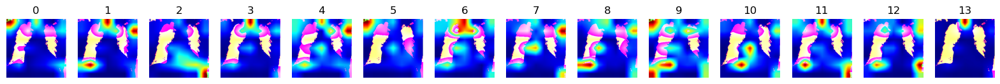

Epoch 15/15, Loss: 0.0250: 100%|██████████████| 157/157 [24:49<00:00,  9.48s/it]


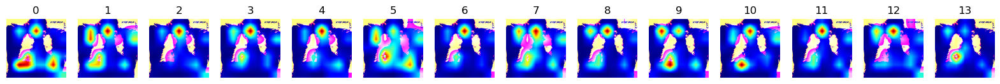

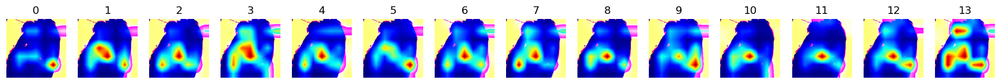

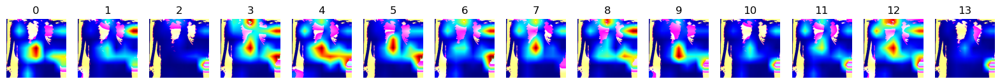

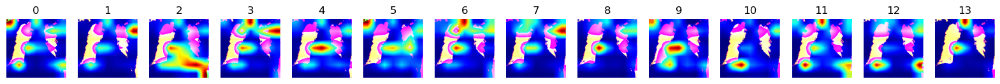

In [10]:
### not pretrained
print(f'\n\n\n ========== Without Pretrained Weights ========== \n\n\n')
model = models.resnet50(weights=None)
model.fc = nn.Linear(model.fc.in_features, 14)
model.to(device)
training(model)
### pretrained
print(f'\n\n\n ========== With Pretrained Weights ========== \n\n\n')
model = models.resnet50(weights='DEFAULT')
model.fc = nn.Linear(model.fc.in_features, 14)
model.to(device)
training(model)

### How does the model change which features it looks at during different stages of training?

The diagrams change significantly over the course of the training, in particular the contrast between the two models (pre-trained and non-pre-trained) should be emphasized. In the table above (always the same four images of the validation set), it can be seen that the activation areas initially (or without pre-trained weights) appear random or uninterpretable. However, as training progresses (or with pre-trained weights, but also in both training processes separately), the model tends to focus on relevant parts of the image that are important for classification. You can also see that the model learns to consider different features for each individual class, although some features the individual classes look at are overlapping.

### Why was that data split decision made?

CheXpert is a large dataset with over 200,000 images, training a model on the entire dataset would require significant computational resources. Because of limited resources, a smaller subset of 1000 instances was chosen to speed up training and to be able to experiment with different approaches in quick iterations.
Given the extensive dataset, I opted not to utilize 10% or 15% of the entire training dataset for testing. Instead, I chose to use 500 instances, which I deemed sufficient. This decision allows for the utilization of a substantial number of instances for training, given the availability of computational resources.
It's essential to acknowledge that certain pathologies may be more prevalent than others in the dataset. To address this, StratifiedShuffleSplit could have been employed. This method ensures that the subset maintains a balanced representation across different classes, promoting a fair evaluation of the explanation method.

### a) Why might the CheXpert dataset be challenging to train a typical model on:

Label Uncertainty: The dataset includes uncertain labels (-1), indicating that the radiologist was uncertain about the presence or absence of certain pathologies. Handling these uncertain labels requires specific strategies, as demonstrated in the code (e.g., converting uncertain labels to either 0 or 1 based on a chosen policy).
Imbalanced Data: Medical datasets often suffer from class imbalance, where certain pathologies are more prevalent than others. This can make it challenging for the model to learn from less frequent classes.
Complex Medical Image Interpretation: Interpreting medical images is a complex task that requires understanding subtle patterns and variations. The model needs to learn both low-level and high-level features to make accurate predictions.
Multi-Label Nature: Due to its multi-label nature, where images may have features associated with multiple classes simultaneously, this dataset is challenging to train on.

### b) How to address these challenges:

Label Smoothing or Modification: Techniques such as label smoothing or modification of uncertain labels can be employed to handle uncertain annotations more effectively.
Class Balancing Strategies: Addressing class imbalance through techniques like oversampling minority classes or using class weights during training can help the model better learn from underrepresented classes.
Data Augmentation: Augmenting the dataset through techniques like rotation, flipping, and scaling can help increase the effective size of the dataset and improve model generalization.
Transfer Learning: Leveraging pre-trained models on large datasets can help the model learn useful features that can be beneficial for the CheXpert dataset, especially when the dataset itself is limited (e.g. due to computational resources).

### c) Implications on results:

Generalization Challenges: The challenges in class imbalance and uncertain labels may affect the model's generalization to new and unseen data. It might struggle to accurately predict minority classes and uncertain cases.
Interpretability: Understanding how the model makes decisions is crucial in medical applications. Techniques like Grad-CAM (used in the provided code) can help visualize which regions of the image the model focuses on for making predictions.
Model Evaluation: Evaluation metrics need to be chosen carefully, considering the dataset's characteristics. Common metrics would be sensitivity, specificity, and area under the ROC curve (AUC-ROC).